In [2]:
import os
import pandas as pd
import numpy as np
import utils
from datetime import datetime
import matplotlib.pyplot as plt
import math

c:\Users\agand\OneDrive\Escritorio\lakes\lake-algae-analysis\.venv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:

longitude = 76.8
latitude = 30.73

lakes = utils.get_lakes(longitude, latitude, 5000)

In [4]:
lakes

,element_type,osmid,name,geometry_ws,area,distance,centroid_ws
0,relation,8421510,Sukhna Lake,"POLYGON ((76.81058 30.74594, 76.81046 30.74591...",1.362619e+06,2291.763462,POINT (76.81996 30.74141)


In [101]:
import importlib

importlib.reload(utils)

<module 'utils' from 'c:\\Users\\agand\\OneDrive\\Escritorio\\lakes\\lake-algae-analysis\\notebooks\\utils.py'>

In [3]:
config = utils.get_config()

In [102]:
image = utils.get_image_from_lake(8421510, 'chl', datetime(2020, 6,13), config)

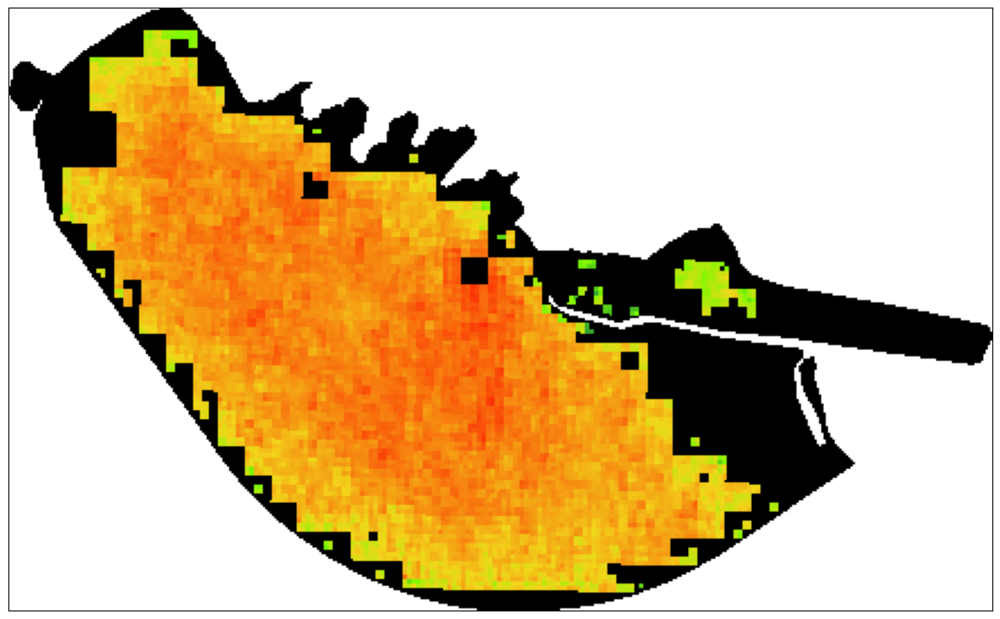

In [108]:
utils.plot_image(image, factor = 1/255, clip_range=(0,1))

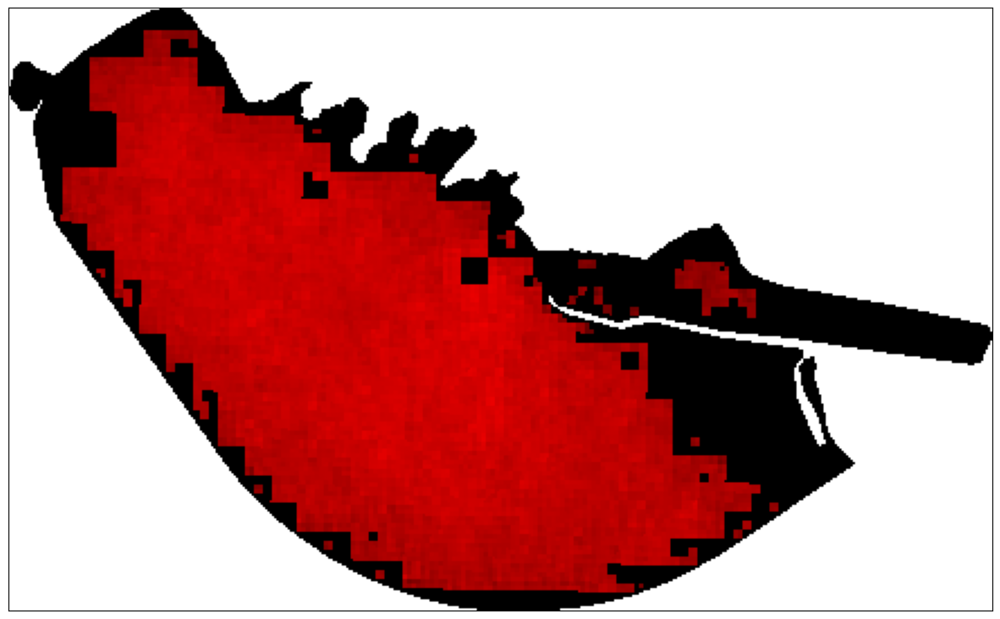

In [107]:
image2 = utils.get_image_from_lake(8421510, 'red', datetime(2020, 6,13), config)
utils.plot_image(image2, factor = 1/255, clip_range=(0,1))


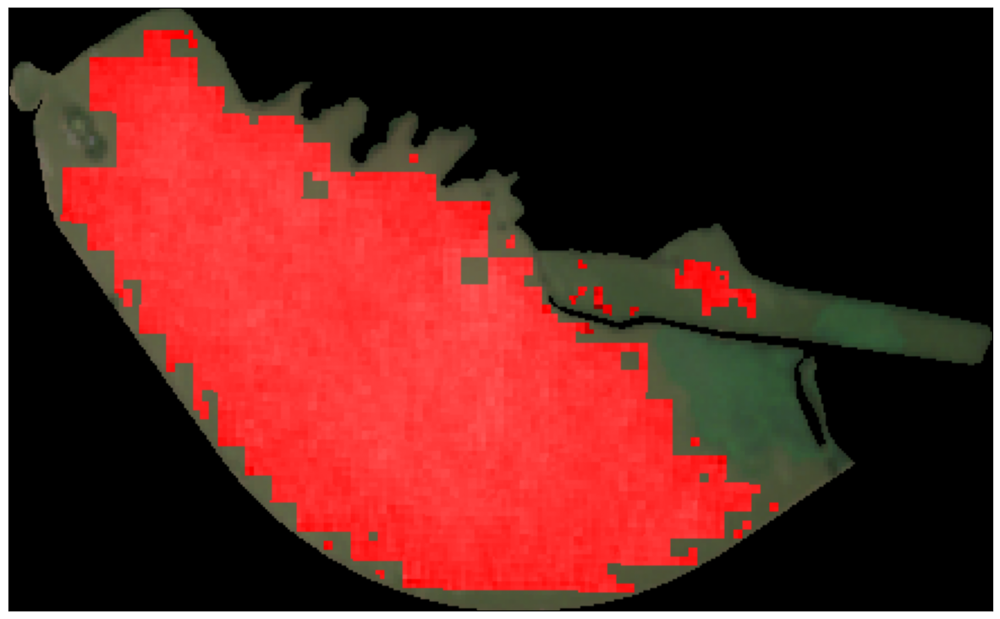

In [114]:
image3 = utils.get_image_from_lake(8421510, 'gr', datetime(2020, 6,13), config)
utils.plot_image(image3, factor = 1/255, clip_range=(0,1))

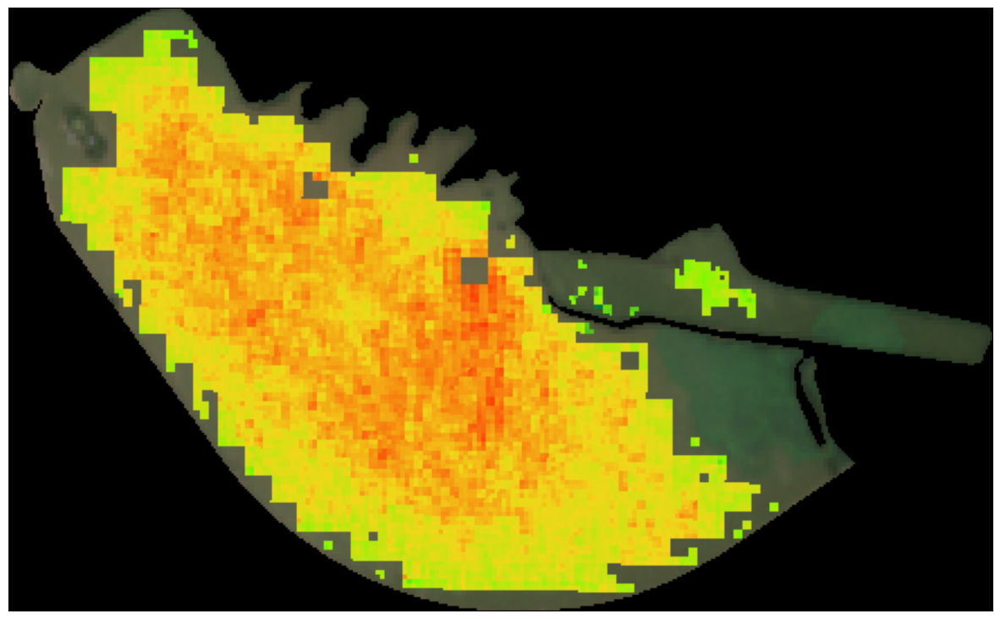

In [113]:
image3 = utils.get_image_from_lake(8421510, 'gr', datetime(2020, 6,13), config)
utils.plot_image(image3, factor = 1/255, clip_range=(0,1))

In [115]:
images = utils.generate_all_type_images_from_lake(8421510, datetime(2020, 7,23), config, save = True)

TRUE
WATER
CLOUD
CHL


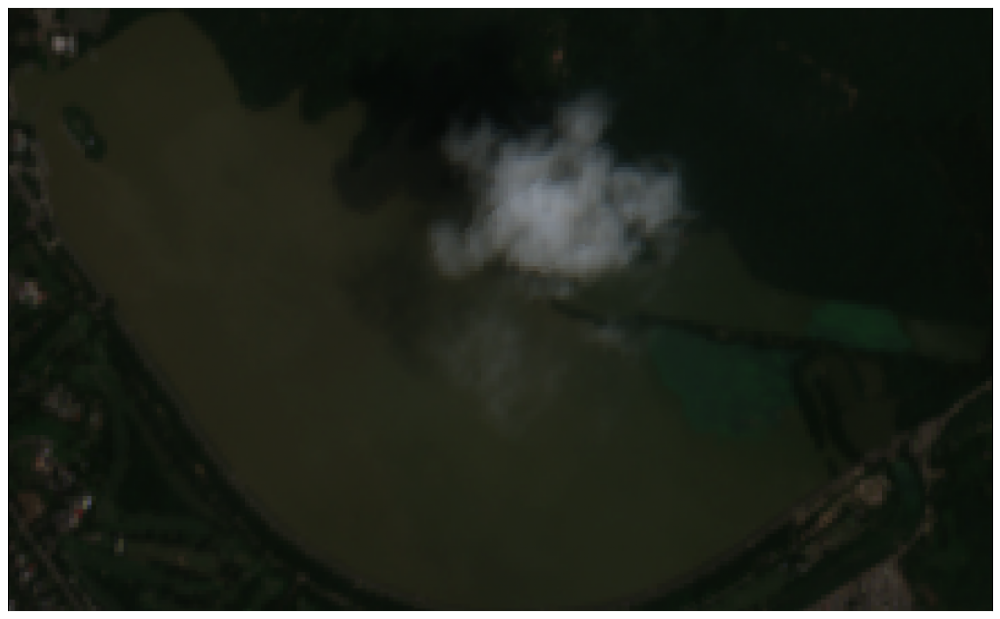

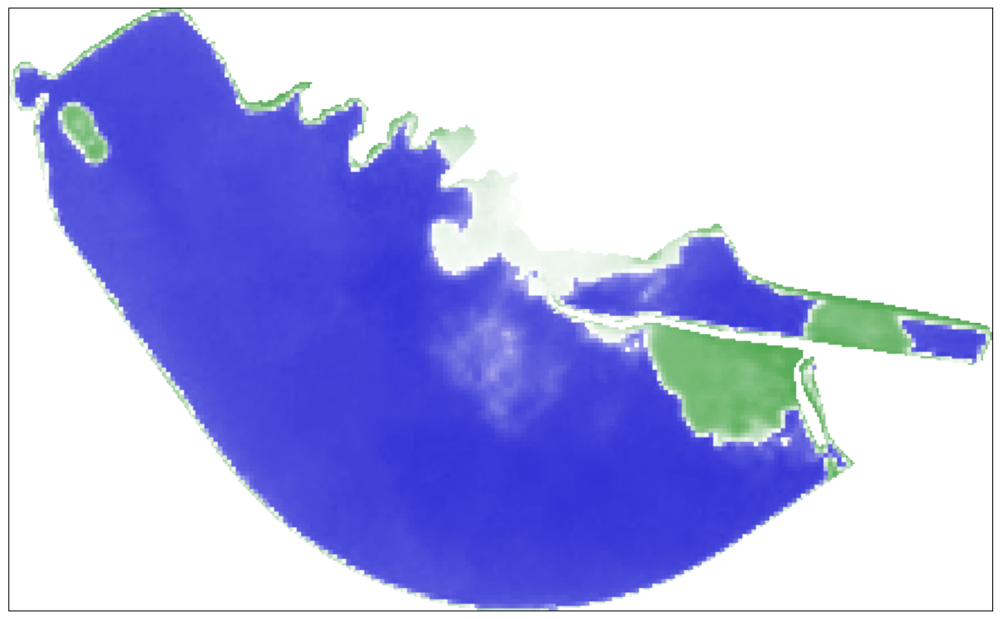

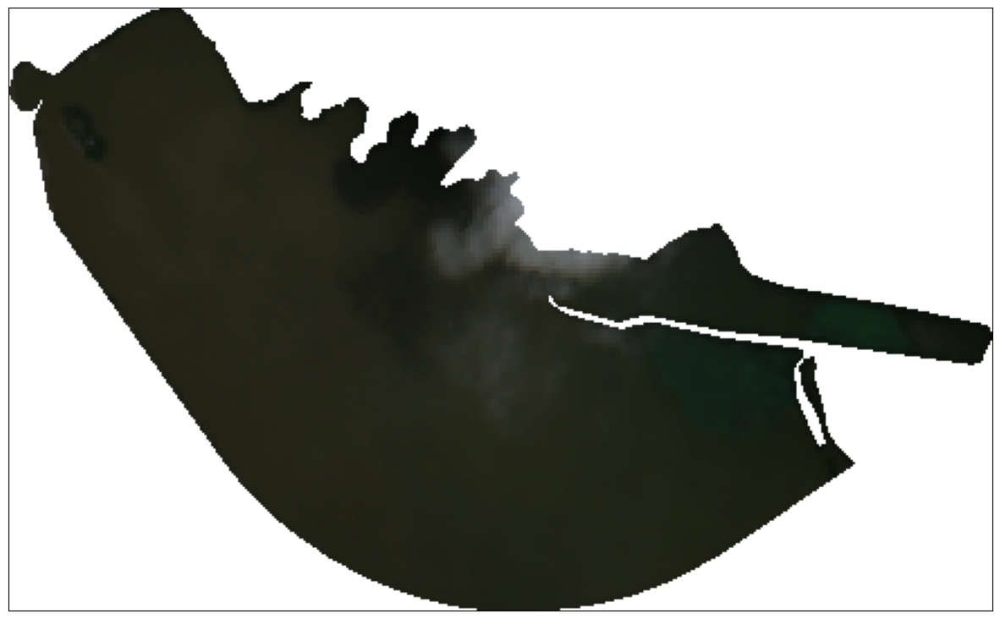

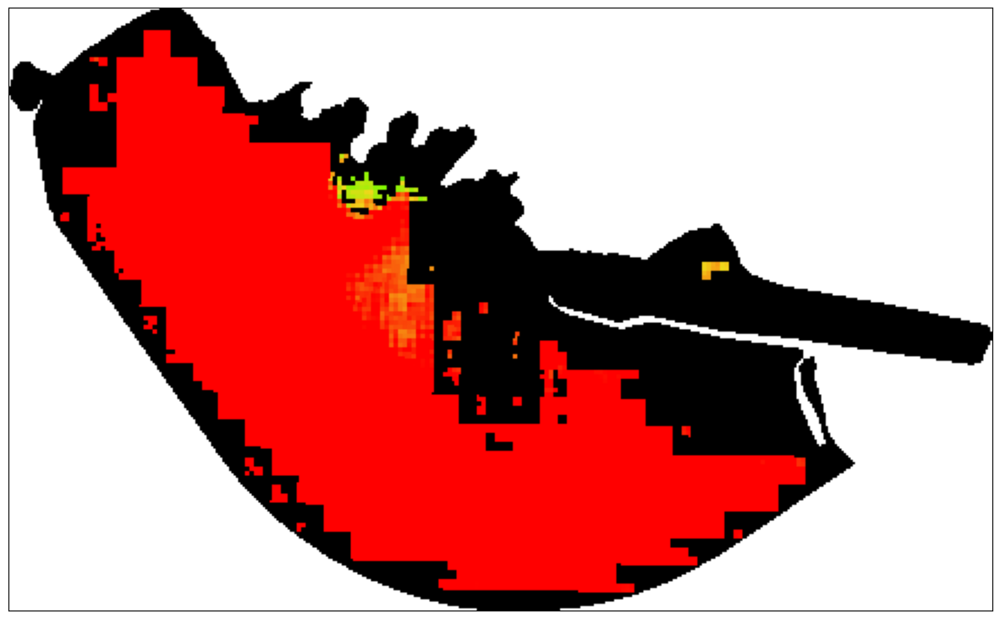

In [116]:
for i in images:
    utils.plot_image(i, factor=1/255, clip_range=(0,1))

In [4]:
historical_images = utils.generate_historical_all_type_images_from_lake(8421510,datetime(2020, 5, 1), datetime(2020, 8,1), config, save = True)

TRUE
WATER
CLOUD
CHL
TRUE
WATER
CLOUD
CHL
TRUE
WATER
CLOUD
CHL
TRUE
WATER
CLOUD
CHL
TRUE
WATER
CLOUD
CHL
TRUE
WATER
CLOUD
CHL
TRUE
WATER
CLOUD
CHL
TRUE
WATER
CLOUD
CHL
TRUE
WATER
CLOUD
CHL
TRUE
WATER
CLOUD
CHL
TRUE
WATER
CLOUD
CHL
TRUE
WATER
CLOUD
CHL
TRUE
WATER
CLOUD
CHL
TRUE
WATER
CLOUD
CHL
TRUE
WATER
CLOUD
CHL
TRUE
WATER
CLOUD
CHL
TRUE
WATER
CLOUD
CHL
TRUE
WATER
CLOUD
CHL


c:\Users\agand\OneDrive\Escritorio\lakes\lake-algae-analysis\notebooks\utils.py:42: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  _, ax = plt.subplots(nrows=1, ncols=1, figsize=(15, 15))


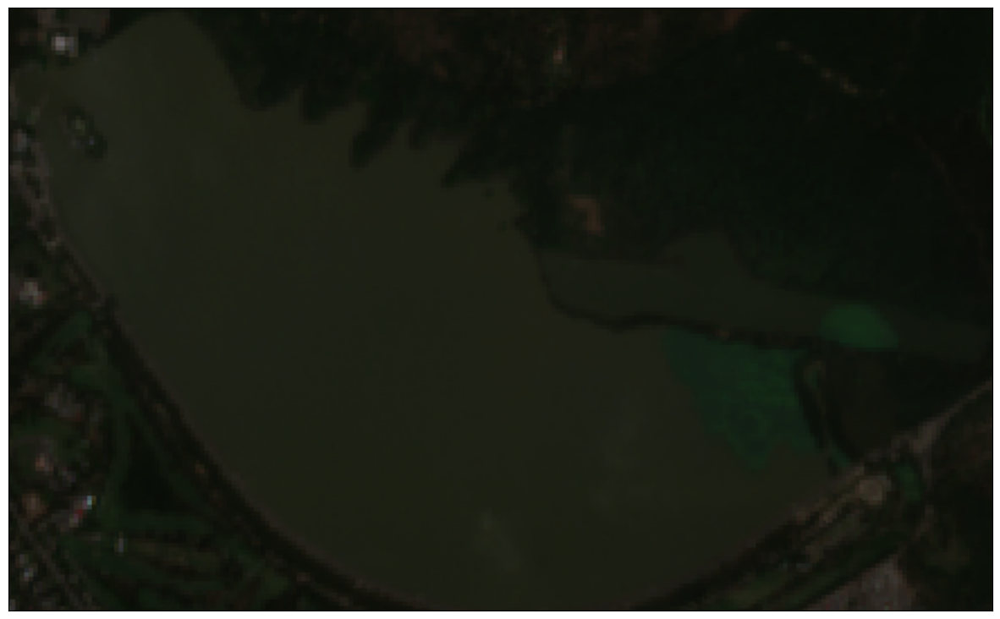

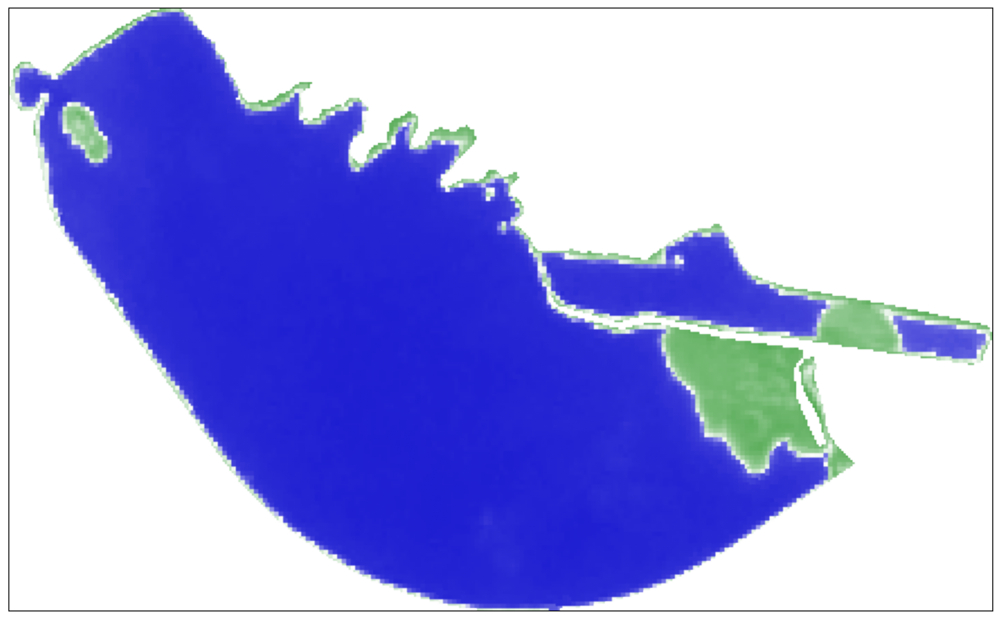

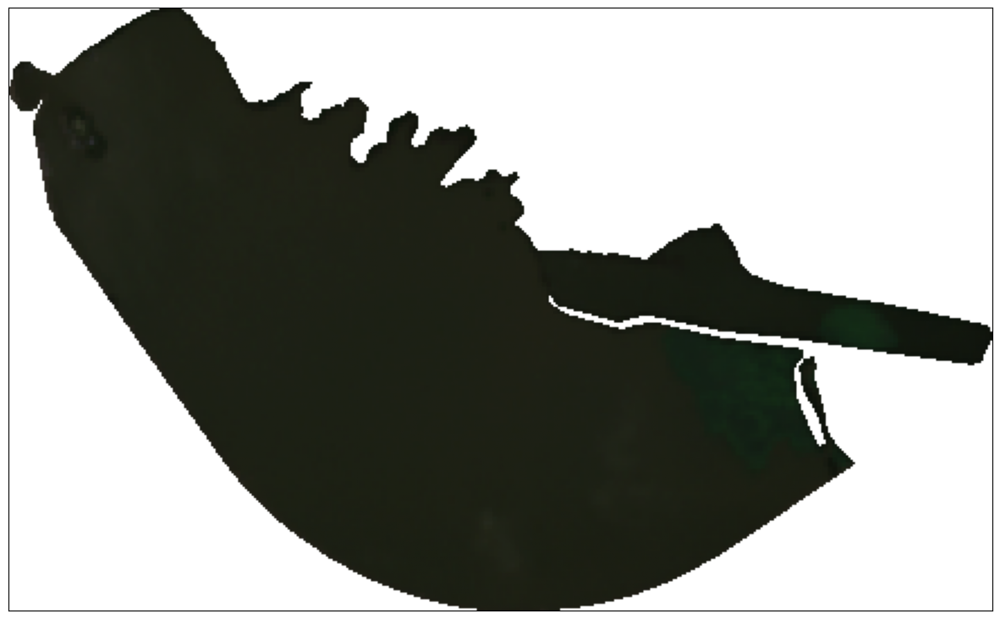

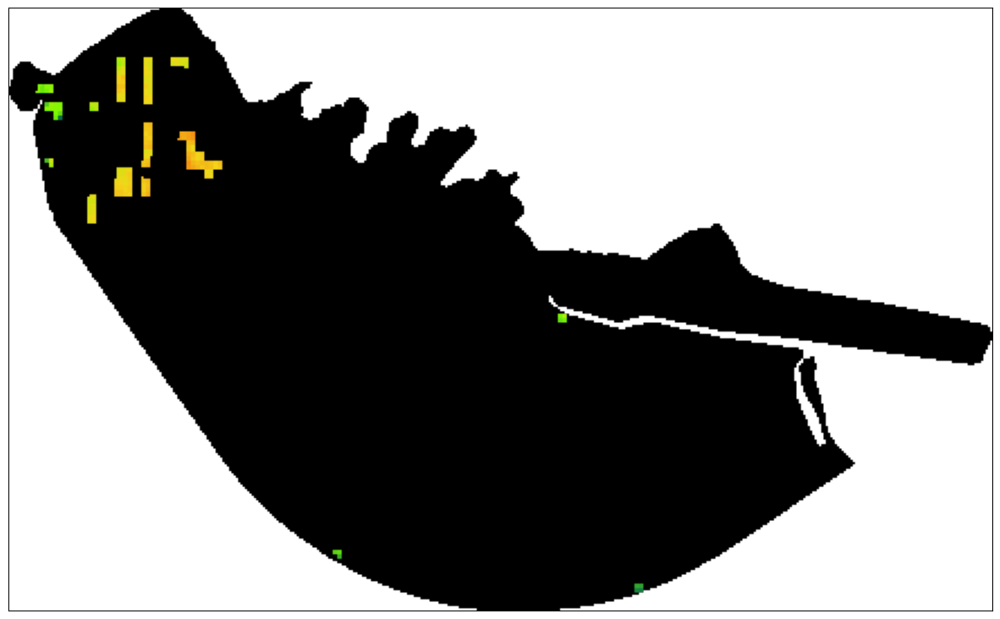

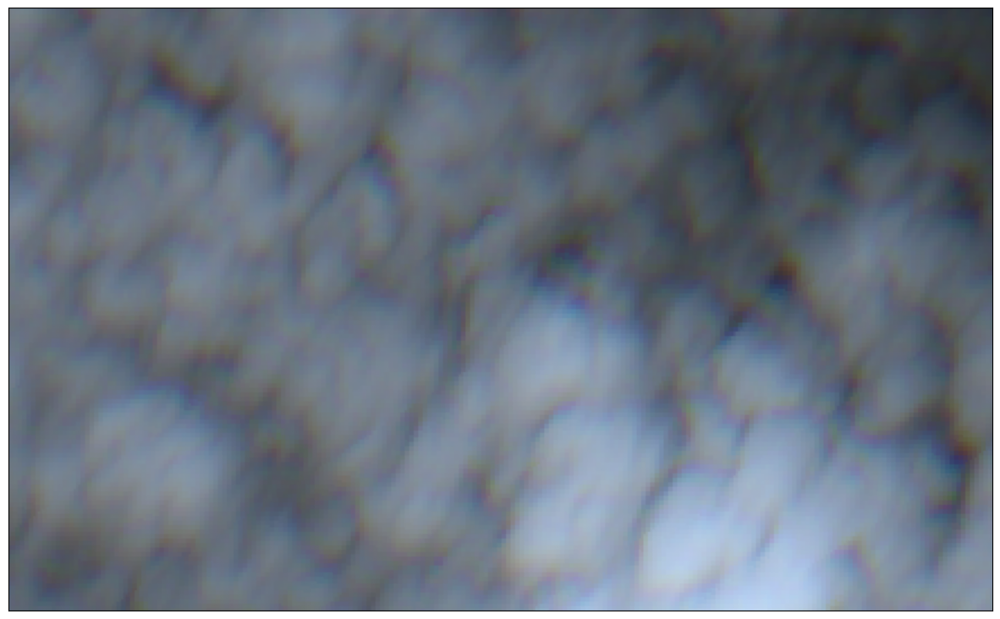

...

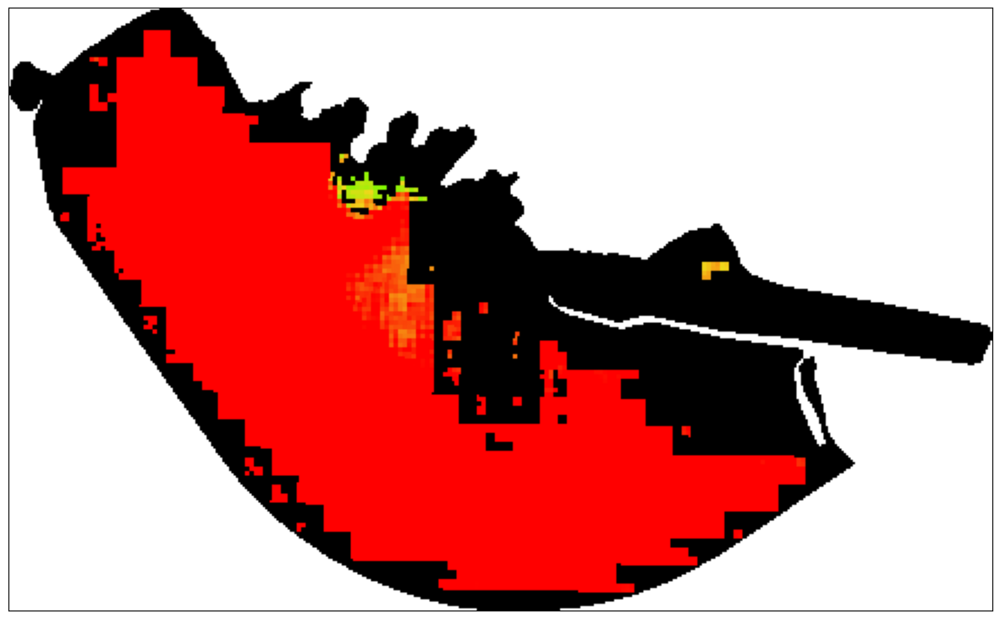

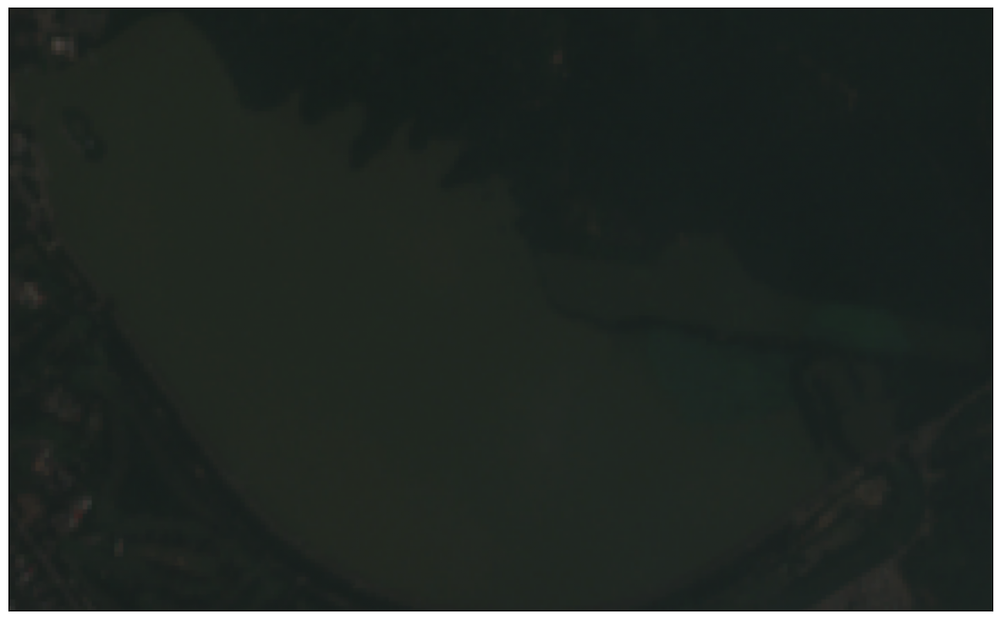

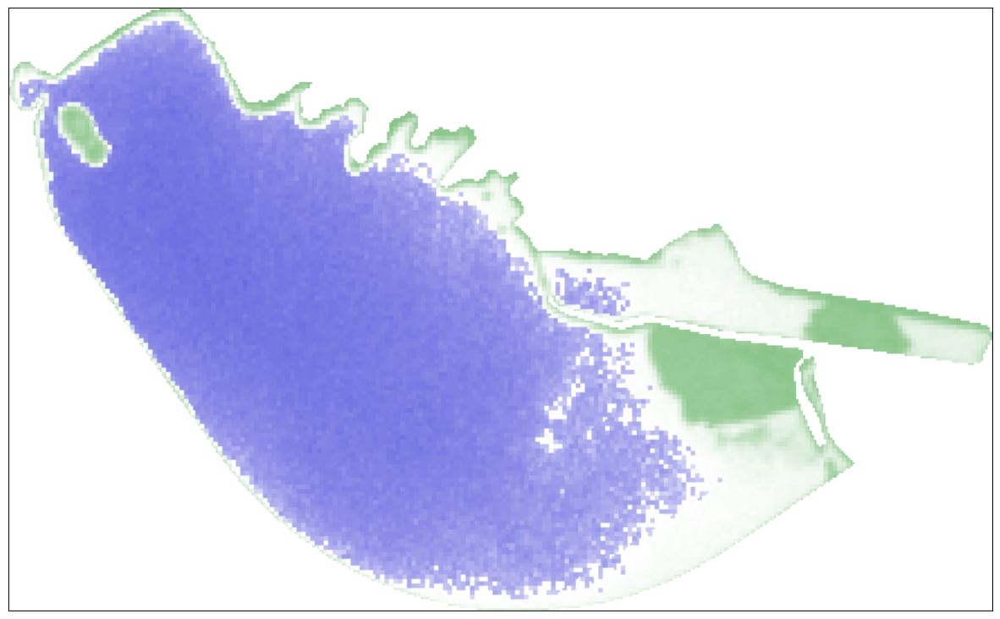

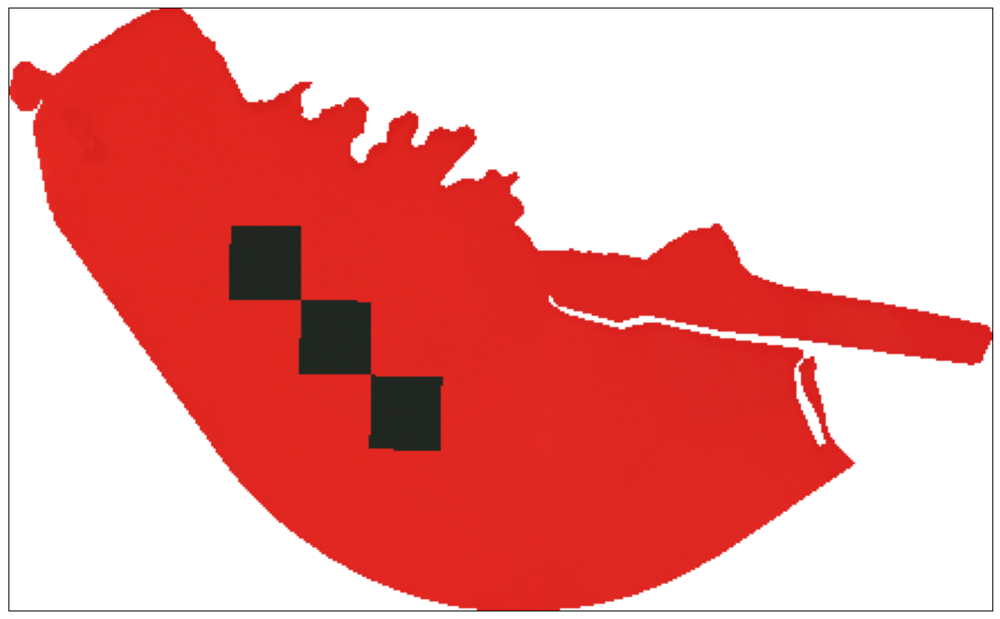

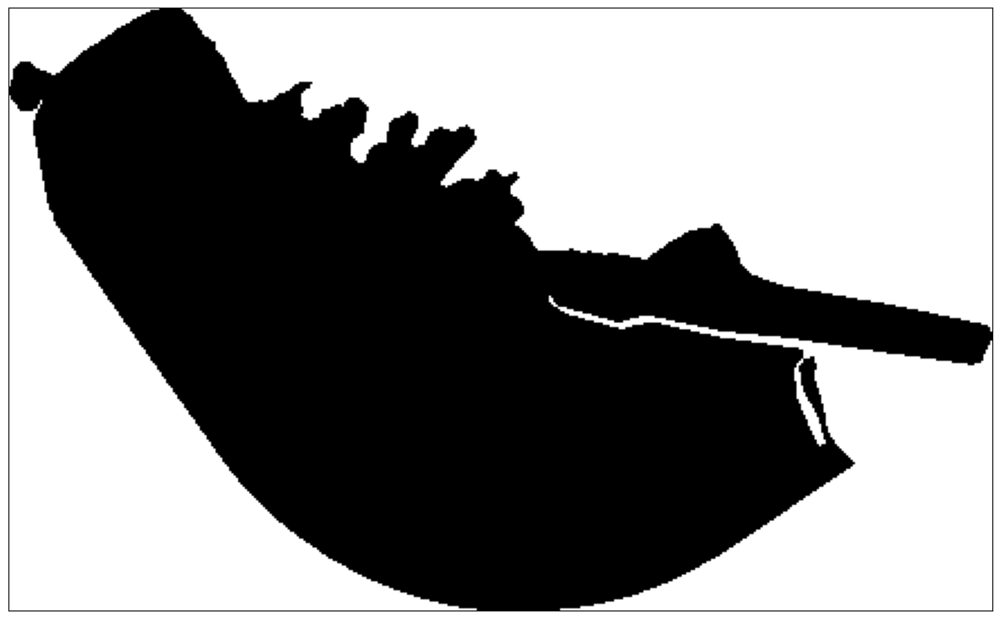

In [5]:
for i in historical_images:
    utils.plot_image(i, factor=1/255, clip_range=(0,1))

In [6]:
osmid = 8421510
date = '2020-07-23'
image_path = (f'../data/{osmid}/{osmid}_chlorophyll_{date}_res5.npy')
# image_path = ('1601368_chl_2020-06-13_res20.npy')
loaded_image = np.load(image_path)



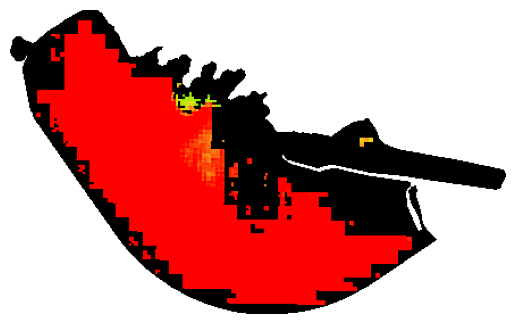

In [7]:
plt.figure()
plt.imshow(loaded_image)
plt.axis('off')
plt.show()

In [8]:
valores_unicos = np.unique(loaded_image.reshape(-1, loaded_image.shape[2]), axis=0)

In [9]:
is_black = np.all(loaded_image[:, :, :3] == [0, 0, 0], axis=-1)
is_white = np.all(loaded_image[:, :, :3] == [255, 255, 255], axis=-1)

# Crear una máscara para píxeles que no sean ni negros ni blancos
mask = ~is_black & ~is_white

In [10]:
non_black_or_white_pixels_count = np.sum(mask)
non_black_or_white_pixels_count

non_black_or_white_pixels = loaded_image[mask]
non_black_or_white_pixels = non_black_or_white_pixels.reshape(-1, loaded_image.shape[2])


In [11]:
reference_colors = np.array([
    [1, 4, 42],    # Very dark blue
    [0, 106, 78],  # Dark teal
    [124, 250, 0], # Bright yellow-green
    [241, 215, 27],# Mustard yellow
    [255, 0, 0]    # Pure red
])

num_breakpoints = len(reference_colors)
start_value = -0.005
end_value = 0.05
breakpoints = np.linspace(start_value, end_value, num_breakpoints)

def find_closest_color(color, reference_colors):
    # Convertir el color a float64 para evitar problemas de tipo
    color = color.astype(np.float64)
    distances = np.linalg.norm(reference_colors - color, axis=1)
    return np.argmin(distances)

def value_from_color(color, reference_colors, breakpoints):
    # Asegurarse de que el color tenga la forma correcta y sea de tipo float64
    color = np.array(color[:3], dtype=np.float64)
    
    # Encontrar el índice del color de referencia más cercano
    closest_index = find_closest_color(color, reference_colors)
    
    # Asegurarse de que el índice no esté fuera de los límites
    if closest_index == len(reference_colors) - 1:
        return breakpoints[closest_index]  # Último color, no hay interpolación
    
    # Colores de referencia y puntos de interrupción adyacentes
    prev_color = reference_colors[closest_index].astype(np.float64)
    next_color = reference_colors[closest_index + 1].astype(np.float64)
    prev_breakpoint = breakpoints[closest_index]
    next_breakpoint = breakpoints[closest_index + 1]
    
    # Interpolación lineal para obtener el valor entre los puntos de interrupción
    color_diff = next_color - prev_color
    
    # Evitar división por cero
    color_ratio = np.divide((color - prev_color), color_diff, out=np.zeros_like(color), where=color_diff!=0)
    ratio = np.mean(np.clip(color_ratio, 0, 1))  # Promedio y asegurarse de que esté entre 0 y 1
    
    # Interpolación del valor
    interpolated_value = prev_breakpoint + ratio * (next_breakpoint - prev_breakpoint)
    
    return interpolated_value

mci_pixels = [value_from_color(pixel, reference_colors, breakpoints) for pixel in non_black_or_white_pixels]
print(mci_pixels)

[0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.05, 0.0

In [71]:
non_black_or_white_pixels

array([[255,   0,   0, 255],
       [255,   0,   0, 255],
       [255,   0,   0, 255],
       ...,
       [254,  12,   2, 255],
       [255,   5,   1, 255],
       [255,   5,   1, 255]], dtype=uint8)

In [72]:
unique_values, counts = np.unique(mci_pixels, return_counts=True)

# Mostrar resultados
for value, count in zip(unique_values, counts):
    print(f'Value: {value}, Count: {count}')

Value: 0.02312752679419346, Count: 4
Value: 0.02408150183150183, Count: 4
Value: 0.024499728666395333, Count: 8
Value: 0.025127255460588794, Count: 8
Value: 0.025166429249762583, Count: 4
Value: 0.025375356125356126, Count: 6
Value: 0.025414529914529915, Count: 4
Value: 0.026002882919549587, Count: 4
Value: 0.026669583502916837, Count: 4
Value: 0.02708781033781034, Count: 4
Value: 0.027205331705331705, Count: 4
Value: 0.02754521096187763, Count: 4
Value: 0.027548941798941802, Count: 4
Value: 0.02758438475105142, Count: 5
Value: 0.027623558540225208, Count: 4
Value: 0.02825108533441867, Count: 4
Value: 0.028499185999186, Count: 14
Value: 0.02853835978835979, Count: 4
Value: 0.02870848595848596, Count: 4
Value: 0.02874765974765975, Count: 8
Value: 0.036250000000000004, Count: 4
Value: 0.03627131782945737, Count: 4
Value: 0.03629263565891473, Count: 4
Value: 0.03641975308641976, Count: 4
Value: 0.03658950617283951, Count: 12
Value: 0.036811087527172805, Count: 8
Value: 0.03683240535663017

In [73]:
def calcular_chl(mci):
    if mci<0:
        return 0
    return math.exp((mci + 0.017) / 0.0077)

chl_pixels = [calcular_chl(pixel)*25 for pixel in mci_pixels]
chl_pixels

total_chl = np.sum(chl_pixels)

In [74]:
total_chl

4677147824.246762

In [45]:
calcular_chl(0.3285493827160494)


3.087699894417972e+19

In [12]:
reference_colors

array([[  1,   4,  42],
       [  0, 106,  78],
       [124, 250,   0],
       [241, 215,  27],
       [255,   0,   0]])

In [15]:
diference_colors = []
n = len(reference_colors)
for i in range(n-1):
    dif_color = reference_colors[i+1]-reference_colors[i]
    diference_colors.append(dif_color)

diference_colors



[array([ -1, 102,  36]),
 array([124, 144, -78]),
 array([117, -35,  27]),
 array([  14, -215,  -27])]

In [21]:
print(find_closest_color(np.array([70,20, 20]), reference_colors))

0


In [22]:
np.linalg.norm(np.array([60,20,20]))

66.332495807108

66.332495807108